In [ ]:
#@title Установка зависимостей
!pip install git+https://github.com/Badim41/network_tools.git

import datetime
from IPython.display import display, Image, clear_output, HTML, Video, Audio
import ipywidgets as widgets
import mimetypes
import time
import base64

from network_tools import NetworkToolsAPI, ImageModels, AspectRatio, ImageChangeModels, Upscale_Mode, HailuoLanguages

last_file_path = None

upload_widget = widgets.FileUpload(accept='image/*', multiple=False)
def on_upload_change(change):
    global last_file_path
    if upload_widget.value:
        for filename, fileinfo in upload_widget.value.items():
            file_extension = mimetypes.guess_extension(fileinfo['metadata']['type']) or ".png"
            saved_filename = f"image{file_extension}"

            print(f"Загружен файл {saved_filename} ({len(fileinfo['content'])} байт)")
            display(Image(data=fileinfo['content'], width=400))

            with open(saved_filename, 'wb') as f:
                f.write(fileinfo['content'])
            last_file_path = saved_filename

def display_video(video_path):
    with open(video_path, "rb") as video_file:
      video_base64 = base64.b64encode(video_file.read()).decode('utf-8')

    video_html = f"""
    <video width="640" height="480" controls>
      <source src="data:video/mp4;base64,{video_base64}" type="video/mp4">
      Your browser does not support the video tag.
    </video>
    """

    display(HTML(video_html))

def display_glb(file_path):
    with open(file_path, "rb") as file:
        glb_base64 = base64.b64encode(file.read()).decode('utf-8')

    html_content = f"""
    <html>
      <head>
        <script src="https://cdnjs.cloudflare.com/ajax/libs/three.js/r128/three.min.js"></script>
        <script src="https://cdn.jsdelivr.net/npm/three@0.128.0/examples/js/loaders/GLTFLoader.js"></script>
        <script src="https://cdn.jsdelivr.net/npm/three@0.128.0/examples/js/controls/OrbitControls.js"></script>
      </head>
      <body>
        <div id="container" style="width: 500px; height: 500px;"></div>
        <script>
          const scene = new THREE.Scene();
          const camera = new THREE.PerspectiveCamera(75, 1, 0.1, 1000);
          const renderer = new THREE.WebGLRenderer({{antialias: true}});
          renderer.setSize(500, 500);
          renderer.setClearColor(0x404040);
          document.getElementById('container').appendChild(renderer.domElement);

          const controls = new THREE.OrbitControls(camera, renderer.domElement);
          controls.enableDamping = true;
          controls.dampingFactor = 0.25;
          controls.enableZoom = true;

          const ambientLight = new THREE.AmbientLight(0xffffff, 0.5);
          scene.add(ambientLight);
          const directionalLight = new THREE.DirectionalLight(0xffffff, 0.6);
          directionalLight.position.set(0.5, 1, -1.5);
          scene.add(directionalLight);

          const loader = new THREE.GLTFLoader();
          const glbData = atob('{glb_base64}');
          const glbBuffer = new Uint8Array(glbData.length);
          for (let i = 0; i < glbData.length; i++) {{
            glbBuffer[i] = glbData.charCodeAt(i);
          }}

          loader.parse(glbBuffer.buffer, '', (gltf) => {{
            scene.add(gltf.scene);

            const box = new THREE.Box3().setFromObject(gltf.scene);
            const center = box.getCenter(new THREE.Vector3());
            const size = box.getSize(new THREE.Vector3());
            const maxDim = Math.max(size.x, size.y, size.z);

            const fov = camera.fov * (Math.PI / 180);
            let cameraZ = Math.abs(maxDim / 2 / Math.tan(fov / 2));
            camera.position.z = cameraZ * -1.5;
            camera.lookAt(center);

            controls.target.copy(center);
            controls.update();

            function animate() {{
              requestAnimationFrame(animate);
              controls.update();
              renderer.render(scene, camera);
            }}
            animate();
          }}, undefined, (error) => {{
            console.error('Error loading GLB:', error);
          }});
        </script>
      </body>
    </html>
    """
    display(HTML(html_content))

upload_widget.observe(on_upload_change, names='value')

In [ ]:
#@title Ввод API ключа

import getpass
# @markdown Чтобы получить ключ перейдите в бота и пропишите /get_api

# @markdown **(бесплатный баланс 0.5$)**

# @markdown https://t.me/GPT4_Unlimit_bot?start=1
API_KEY = getpass.getpass('Введите API ключ:')
client = NetworkToolsAPI(API_KEY)


In [5]:
#@title ChatGPT API
from network_tools import GptModels

prompt = "Перескажи наш диалог"  # @param {type:"string"}
model = "gpt-4o"  # @param ['gpt-4-5', 'o3-mini', 'o1', 'gpt-4o', 'gpt-4o-mini', 'gpt-3-5', 'claude-3-7', 'claude-3-5-sonnet', 'claude-3-opus', 'claude-3-sonnet', 'claude-3-haiku', 'deepseek-r1', 'deepseek-v3', 'command-r-plus', 'command-a', 'reka-flash', 'minimax_01']
chat_history = [{"role": "user", "content": "2 + 2 ="},{"role": "assistant", "content": "2 + 2 = 4"}]  # @param {type:"raw", description:"Редактируемая история чата"}
stream = True  # @param {type:"boolean", placeholder:"Без вокала?"}

response = client.chatgpt_api(prompt, model=model, chat_history=chat_history, stream=stream)

if stream:
    for chunk in response:
        print(chunk.response.text, end="")
    final_response = chunk
else:
    print(response.response.text)
    final_response = response

print("\n\n🗂 История чата:", final_response.chat_history)


Вы задали вопрос, какой результат дает сумма 2 + 2.

🗂 История чата: [{'role': 'user', 'content': '2 + 2 ='}, {'role': 'user', 'content': 'Перескажи наш диалог'}, {'role': 'assistant', 'content': 'Вы задали вопрос, какой результат дает сумма 2 + 2.'}]


FileUpload(value={'sticker.png': {'metadata': {'name': 'sticker.png', 'type': 'image/png', 'size': 274162, 'la…

Загружен файл image.png (874943 байт)


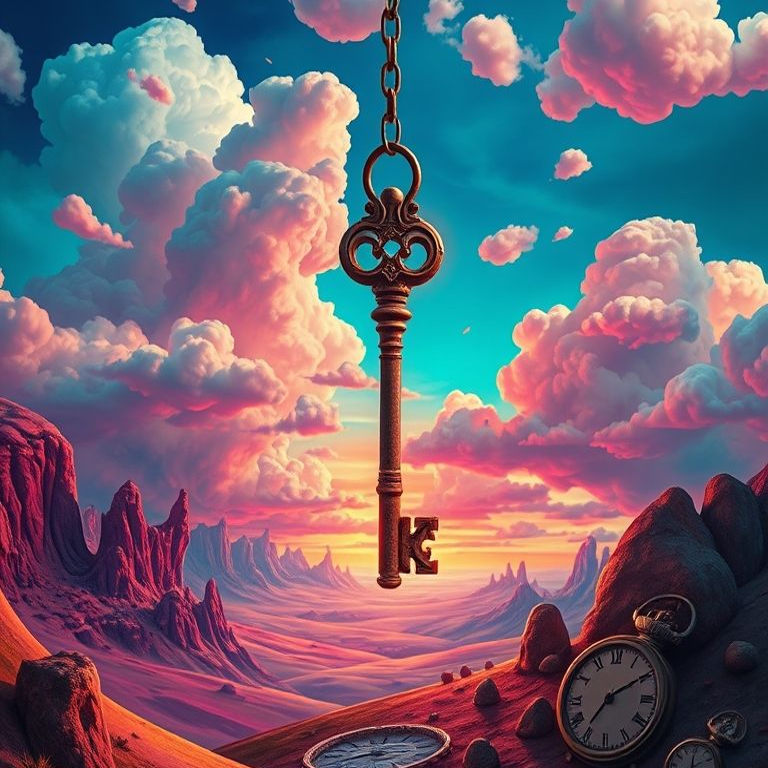

In [ ]:
#@title Загрузка файла для ChatGPT
display(upload_widget)

📝 Ответ: Это сюрреалистическое изображение с ключом, висящим на цепи на фоне фантастического пейзажа с облаками, часами и скалами. Пейзаж выполнен в ярких цветах, создавая атмосферу мечтательного и загадочного мира.
🗂 История чата: [{'content': [{'text': 'Что это?', 'type': 'text'}, {'image_url': {'url': ''}, 'type': 'image_url'}], 'role': 'user'}, {'content': 'Это сюрреалистическое изображение с ключом, висящим на цепи на фоне фантастического пейзажа с облаками, часами и скалами. Пейзаж выполнен в ярких цветах, создавая атмосферу мечтательного и загадочного мира.', 'role': 'assistant'}]

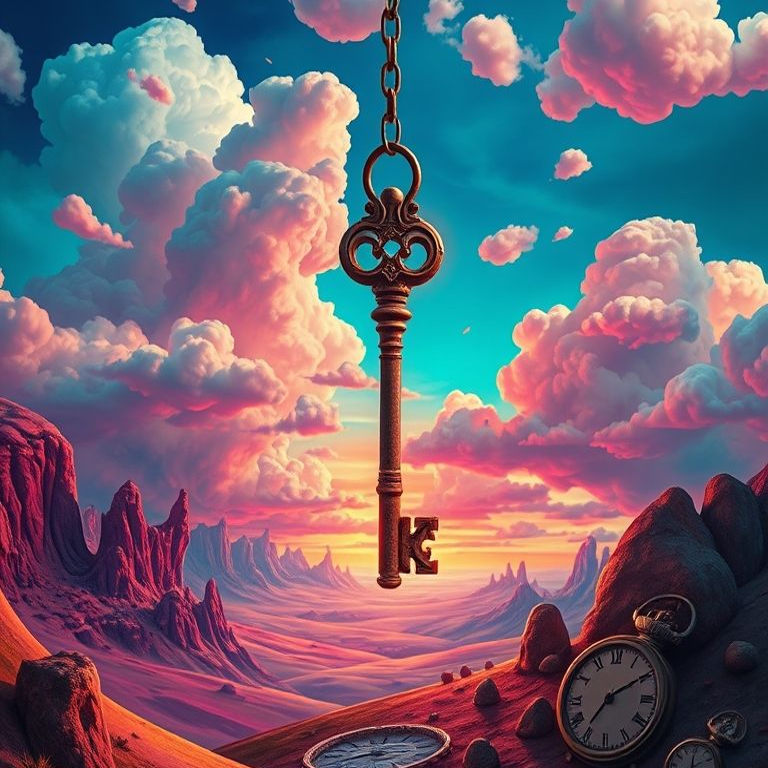

In [ ]:
#@title ChatGPT (загрузка файлов)
prompt = "Что это?"  # @param {type:"string"}
file_path = last_file_path # @param {type:"string"}

chat_history = []  # @param {type:"raw", description:"Редактируемая история чата"}

response = client.chatgpt_api(prompt, model=GptModels.gpt_4o, chat_history=chat_history, file_path=file_path)
print("📝 Ответ:", response.response.text)
print("🗂 История чата:", response.chat_history)

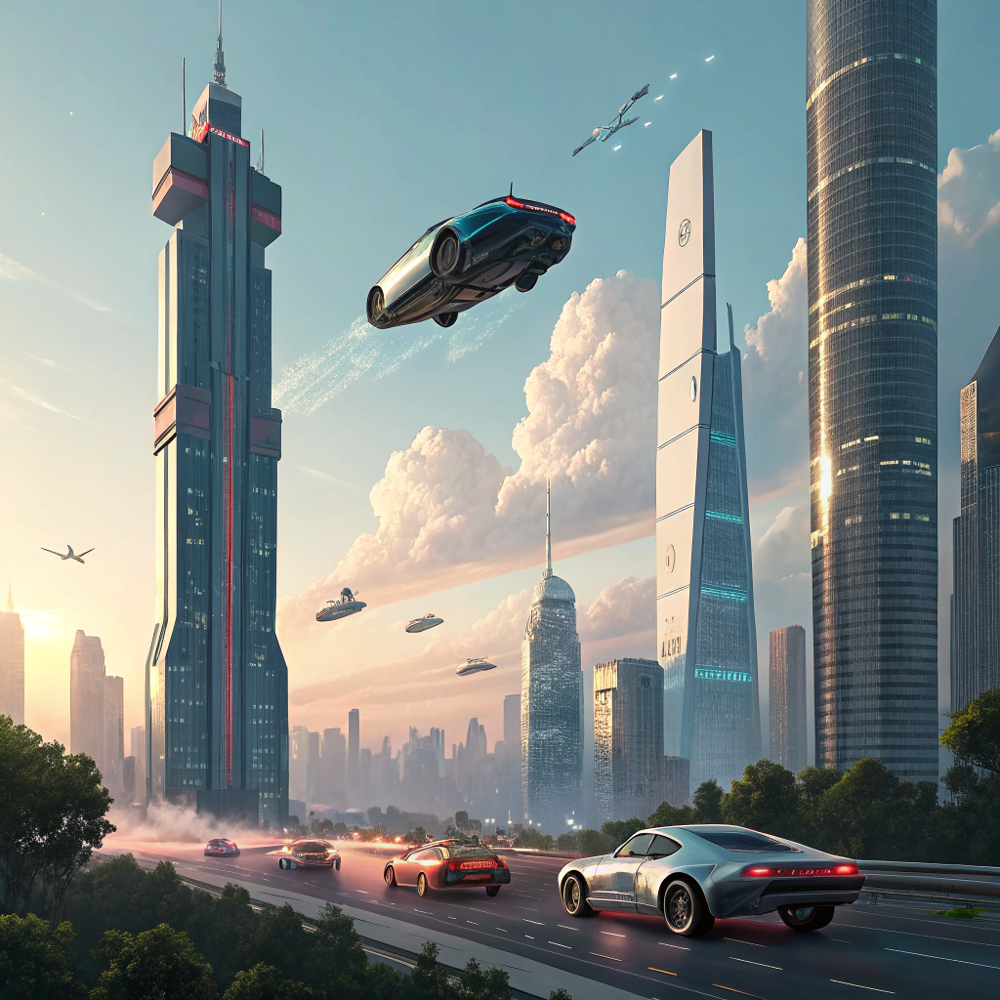

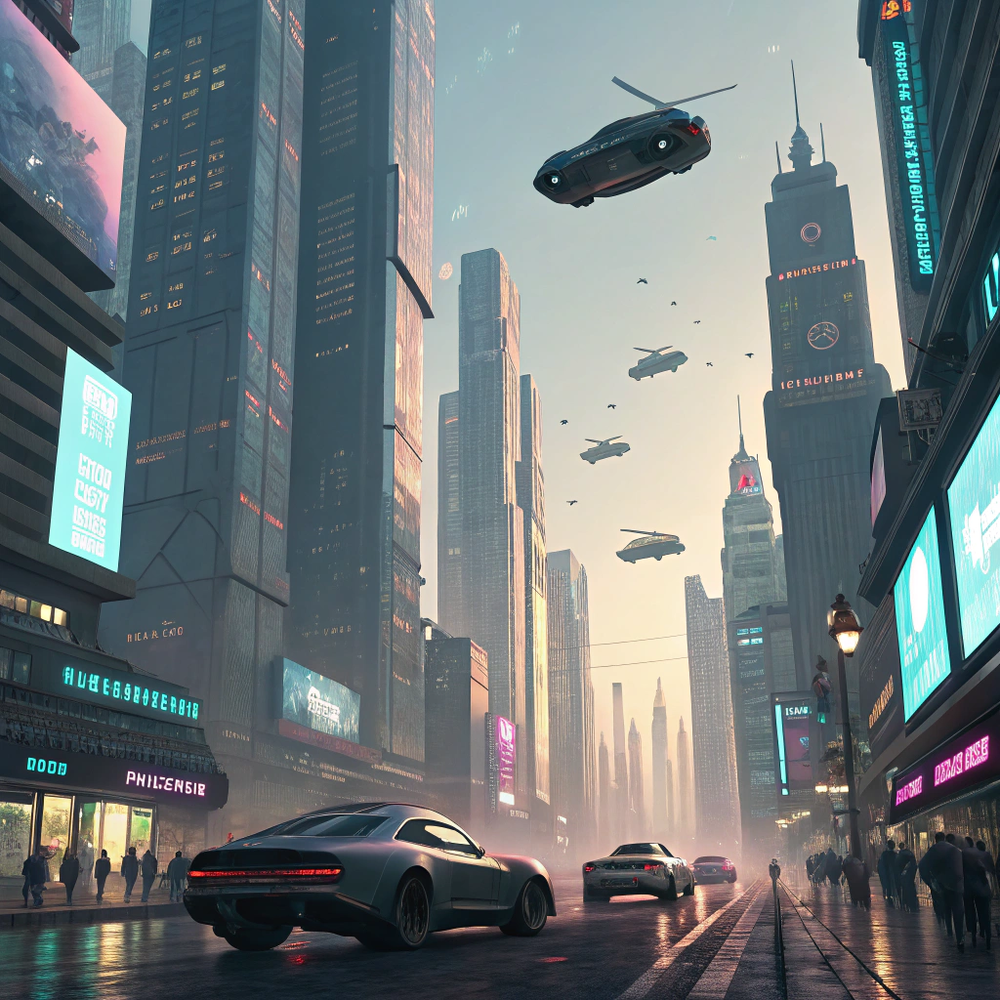

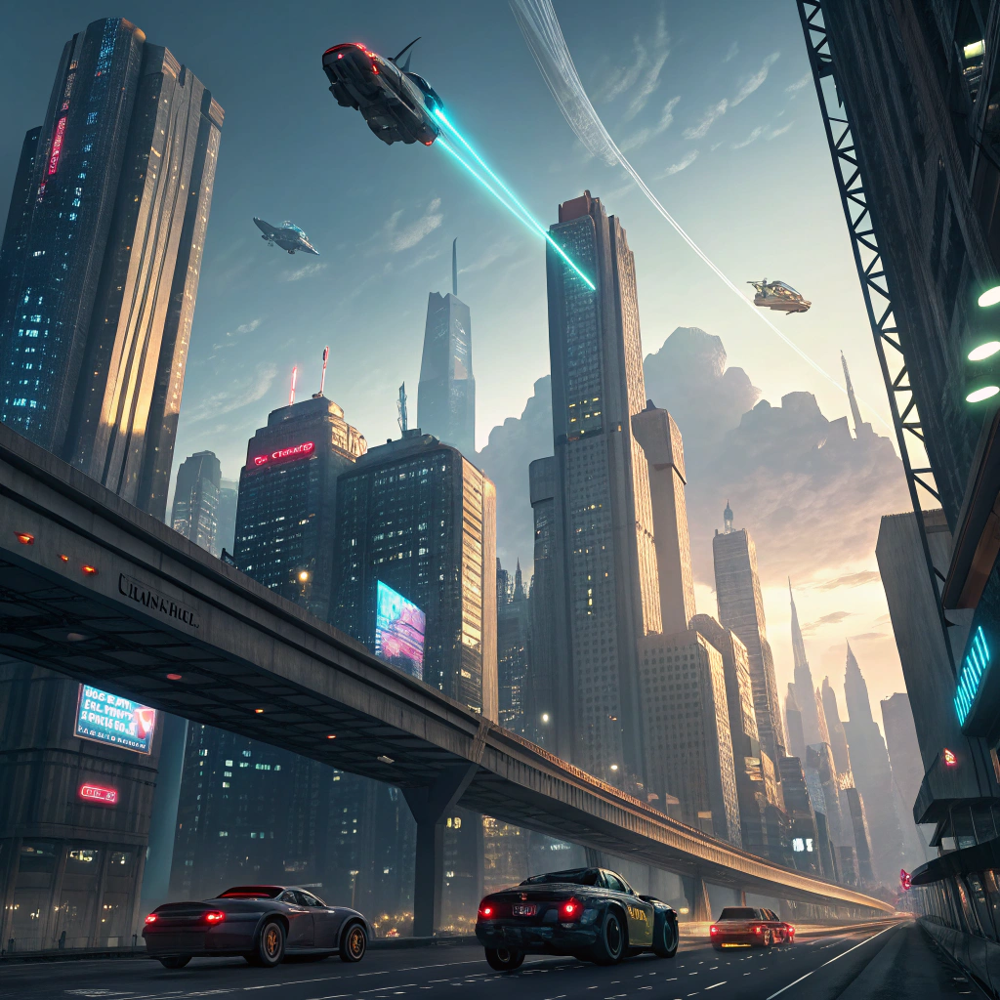

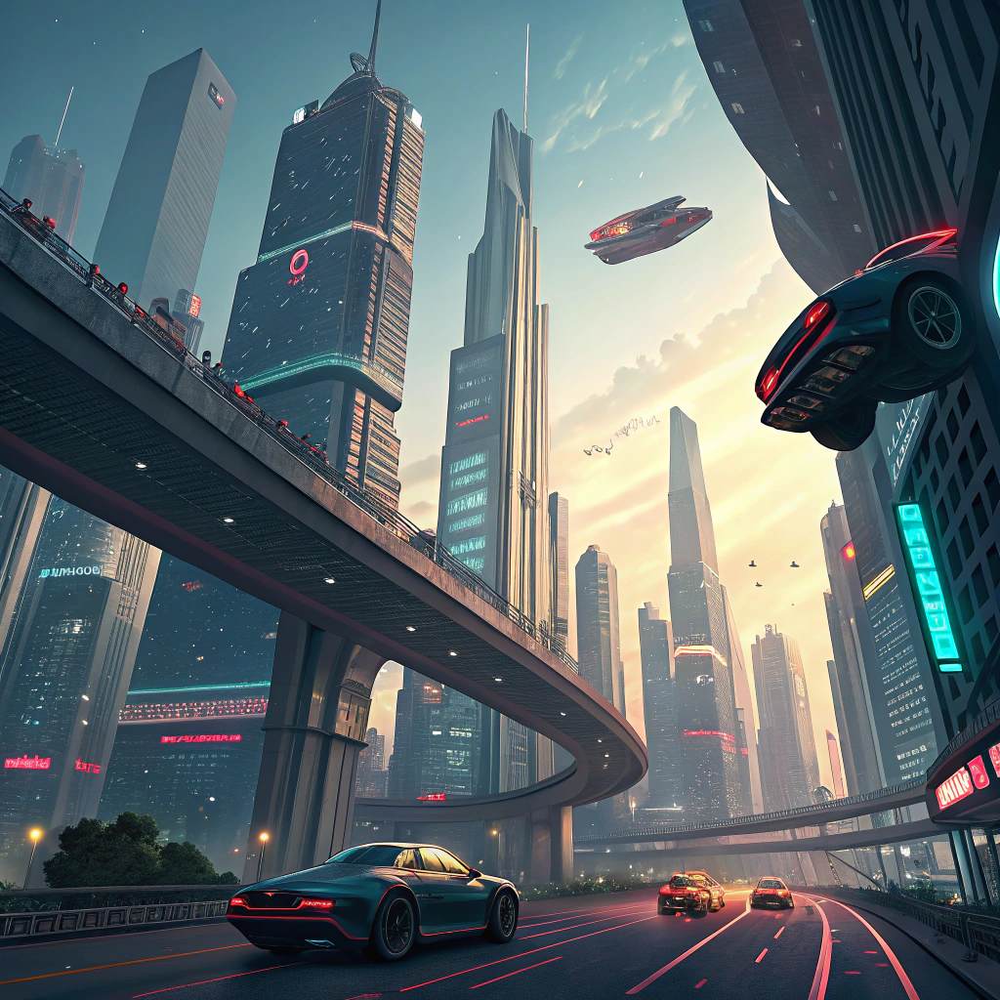

In [ ]:
#@title Генерация изображений
model = "recraft"  # @param ["kandinsky", "dalle_light", "sd_ultra", "sd_xl", "recraft", "dalle_3", "gemini"]
models = [model]

prompt = "A futuristic cityscape with flying cars."  # @param {type:"string"}  # Описание изображения
aspect_ratio = "1:1"  # @param ["1:1", "2:3", "3:2"]

for image_group in client.image_generate_api(models, prompt, aspect_ratio):
    for image_path in image_group:
        display(Image(image_path))


FileUpload(value={}, accept='image/*', description='Upload')

Загружен файл image.png (1238743 байт)


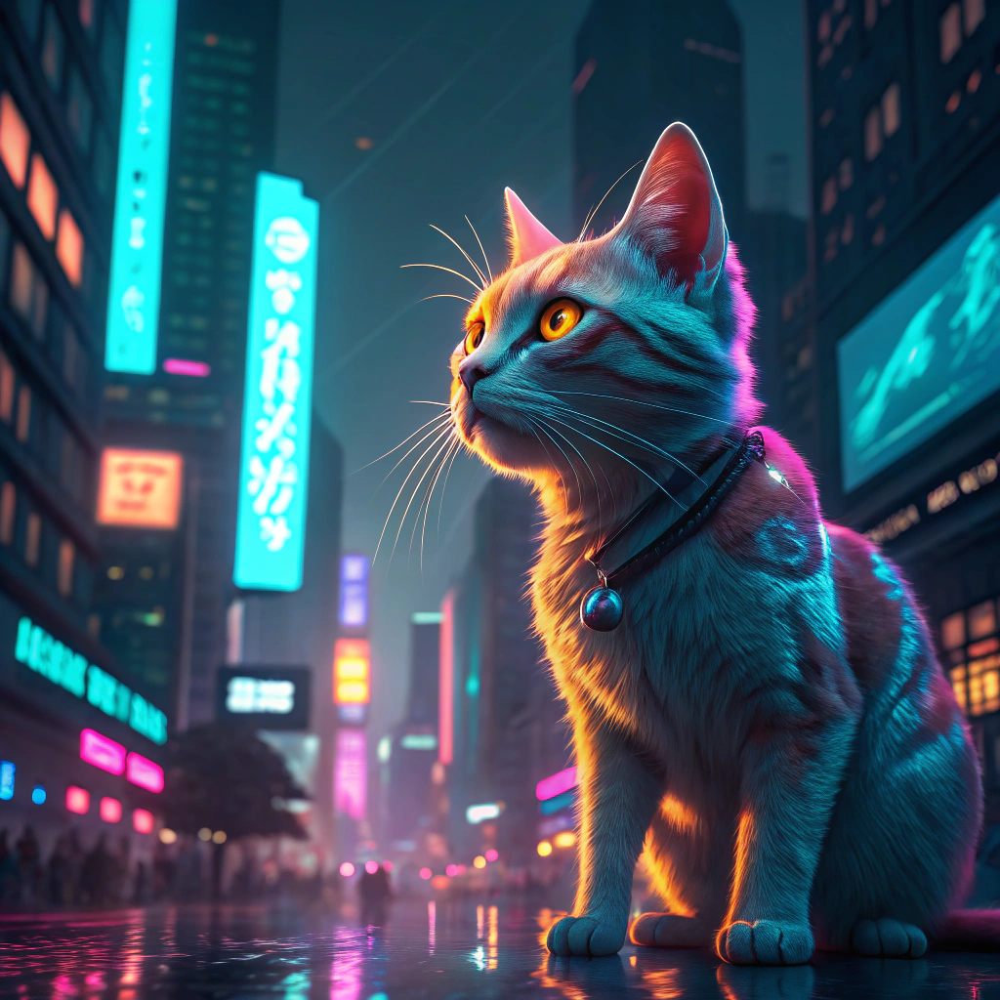

In [7]:
#@title Загрузка изображения через виджет (Upload Image)
display(upload_widget)

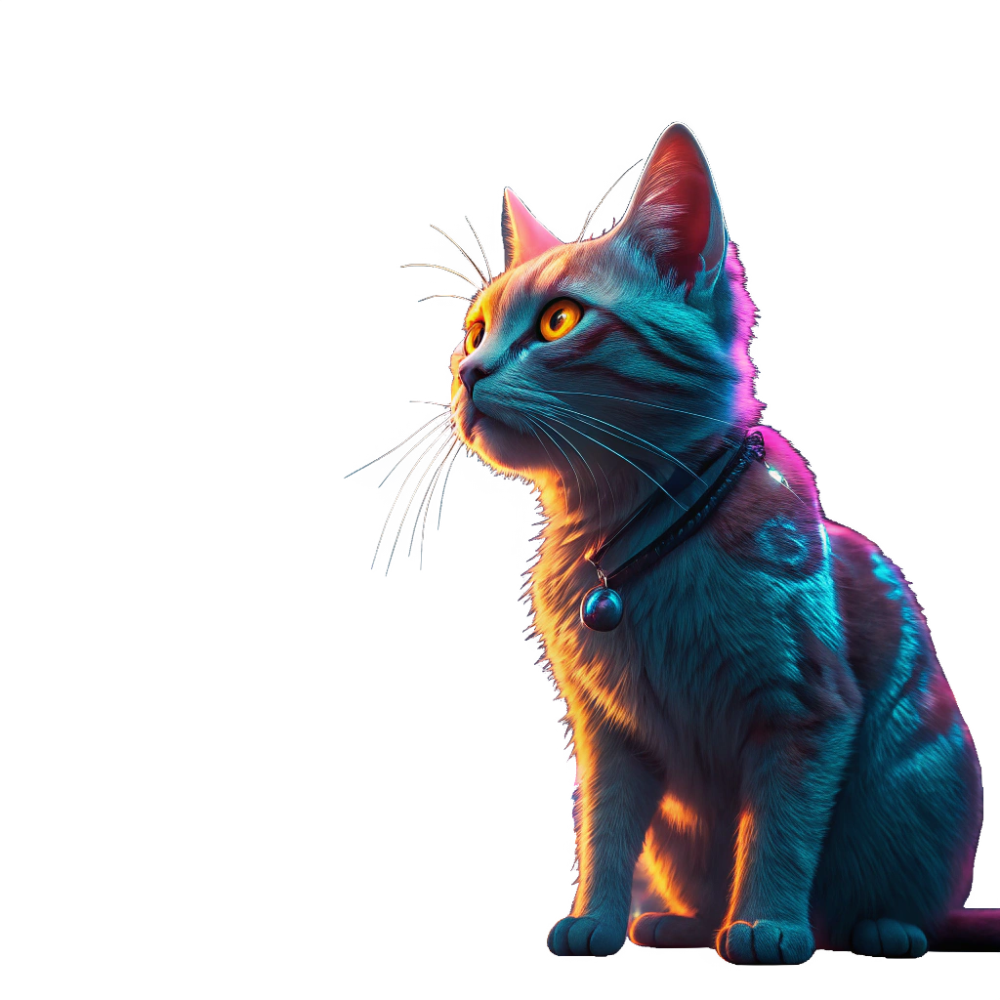

In [ ]:
#@title Remove Background
file_name = "image.png" #@param {type:"string"}
result = client.change_image_api(model="remove_background", image_path=file_name)
img_path = next(result)[0]
display(Image(filename=img_path, width=400))

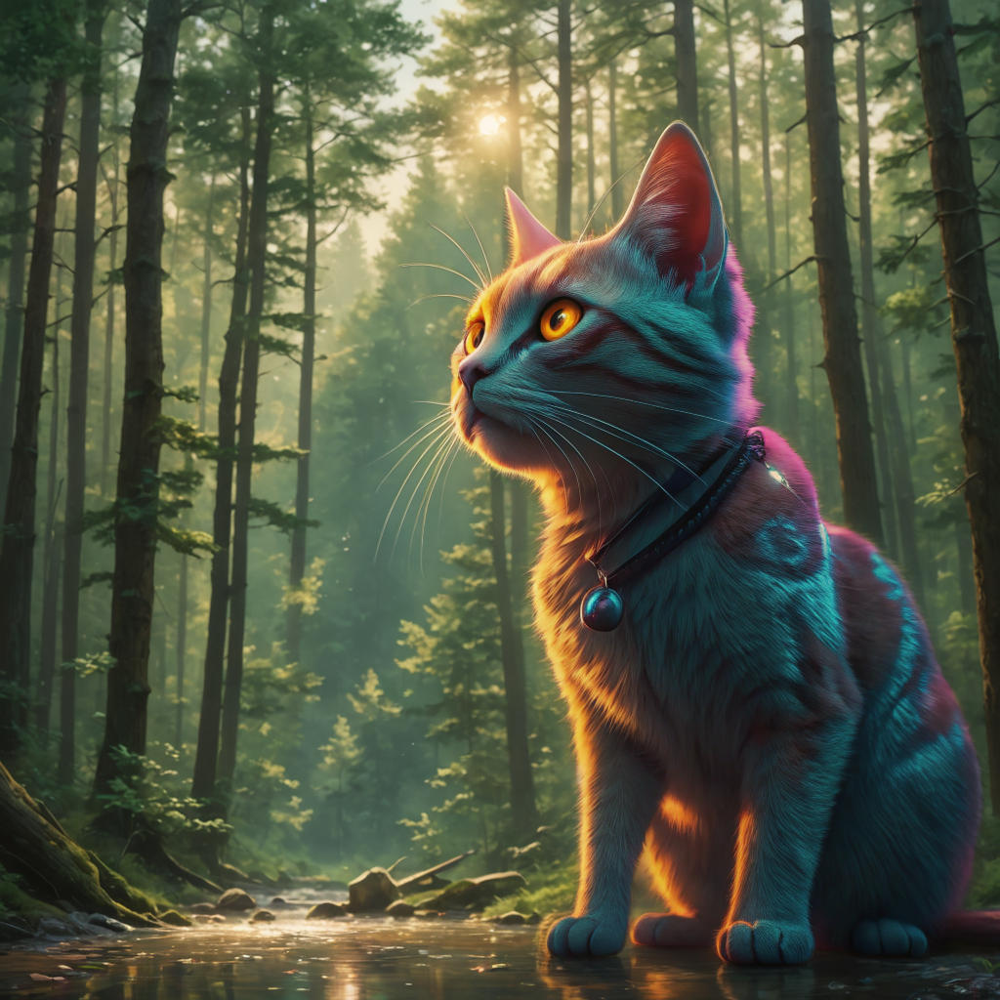

In [ ]:
#@title Change Background & Relight
file_name = "image.png" #@param {type:"string"}
prompt_bg = "Лесной пейзаж" #@param {type:"string", placeholder: "Описание фона"}
result = client.change_image_api(model="change_background", image_path=file_name, prompt=prompt_bg)
img_path = next(result)[0]
display(Image(filename=img_path, width=400))

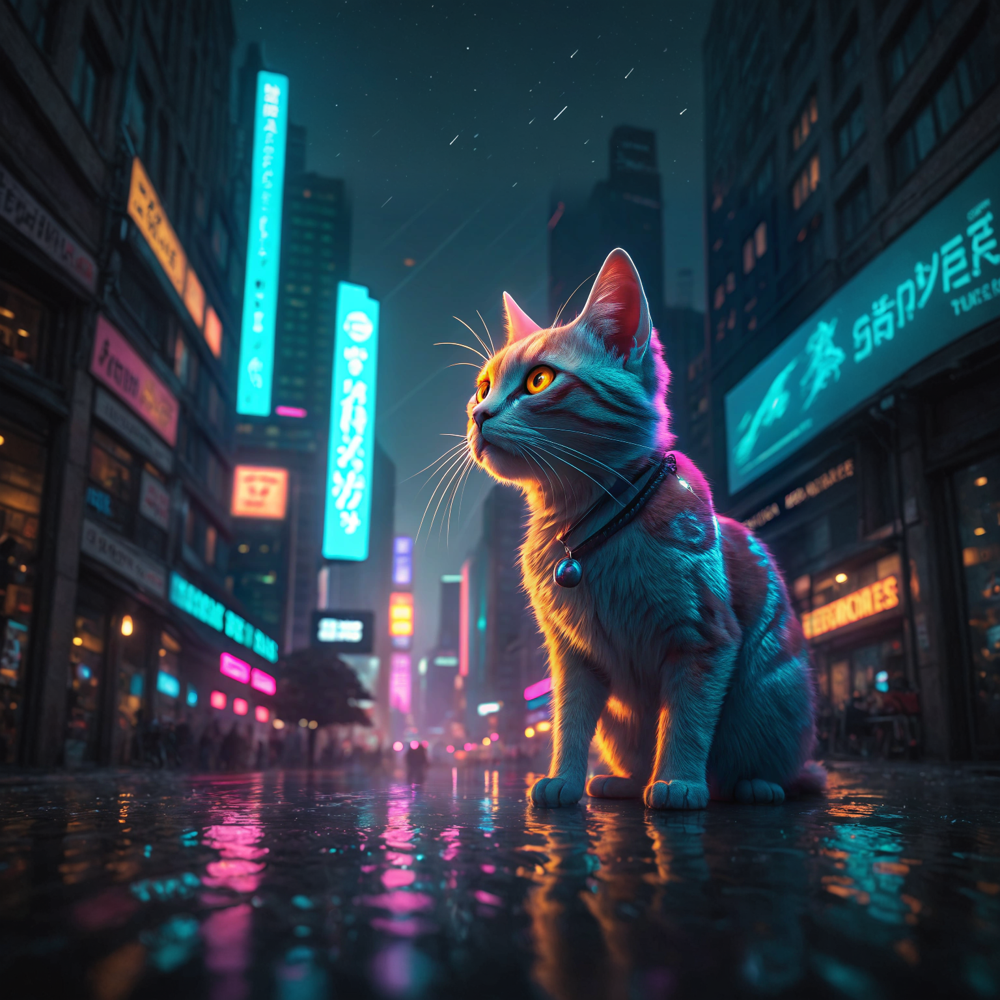

In [ ]:
#@title Outpaint
file_name = "image.png" #@param {type:"string"}
result = client.change_image_api(model="outpaint", image_path=file_name)
img_path = next(result)[0]
display(Image(filename=img_path, width=400))

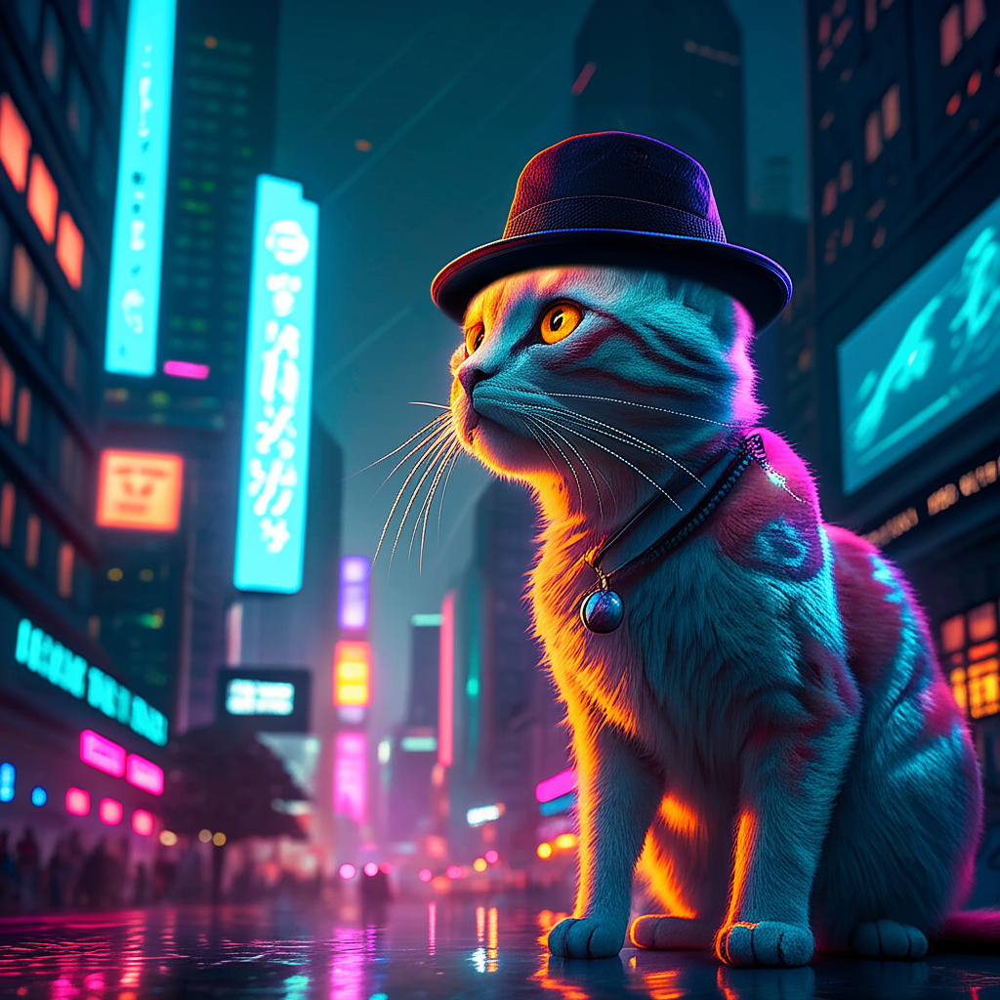

In [11]:
#@title Inpaint
file_name = "image.png" #@param {type:"string"}
prompt_inpaint = "Добавь коту шляпу" #@param {type:"string", placeholder: "Что заменить"}
inpaint_model = "gemini"  # @param ['gemini', 'recraft', 'sd_ultra']
inpaint_models = [inpaint_model]

prompt_remove = "" #@param {type:"string", placeholder: "На что заменить. Не поддерживается Gemini"}
strength=0.5 # @param {type:"float", min:0.0, max:1.0, step:0.01} # Сила изменений. Не поддерживается Gemini

result = client.change_image_api(
    model="inpaint",
    image_path=file_name,
    prompt=prompt_inpaint,
    prompt_2=prompt_remove,
    strength=strength,
    inpaint_models=inpaint_models
)


for group in result:
    for img_path in group:
        display(Image(filename=img_path, width=400))

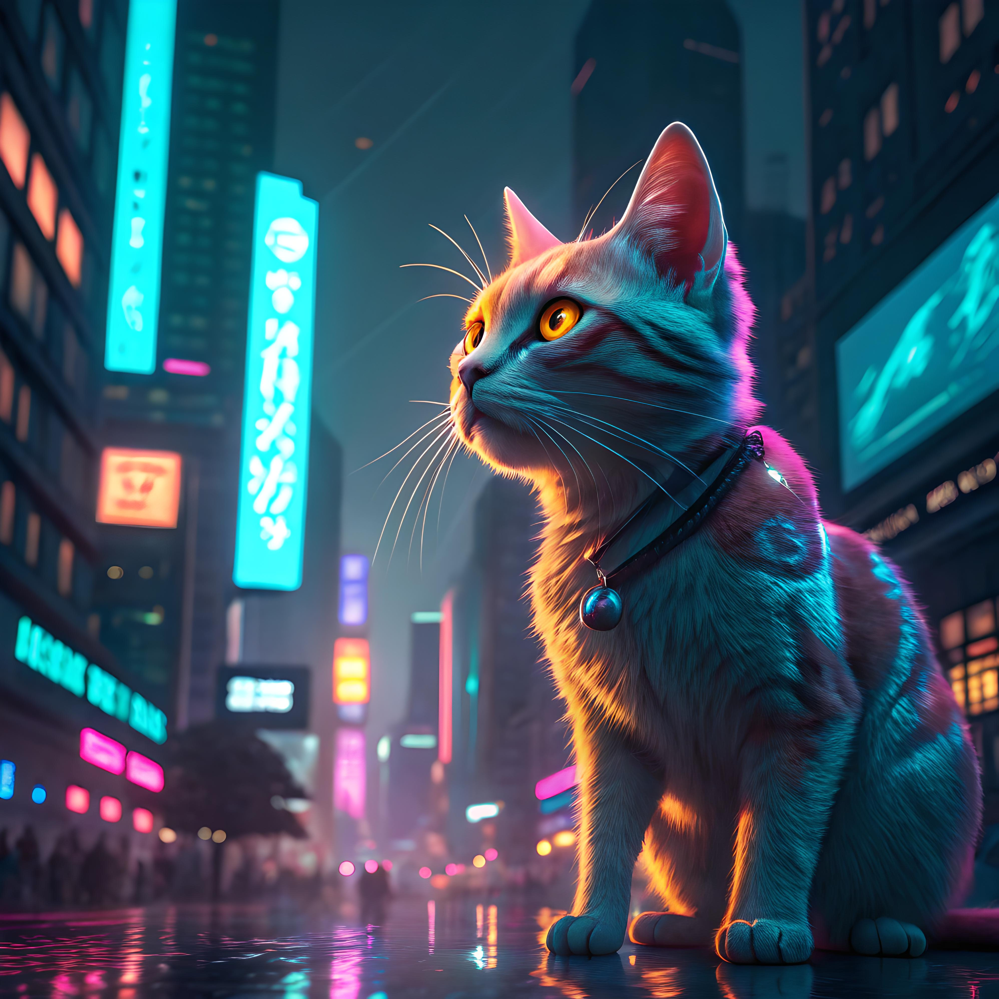

In [ ]:
#@title Upscale
file_name = "image.png" #@param {type:"string"}
upscale_mode = "4K" #@param ["8K", "4K", "HD"]
result = client.change_image_api(model="upscale", image_path=file_name, prompt=upscale_mode)
img_path = next(result)[0]
display(Image(filename=img_path))

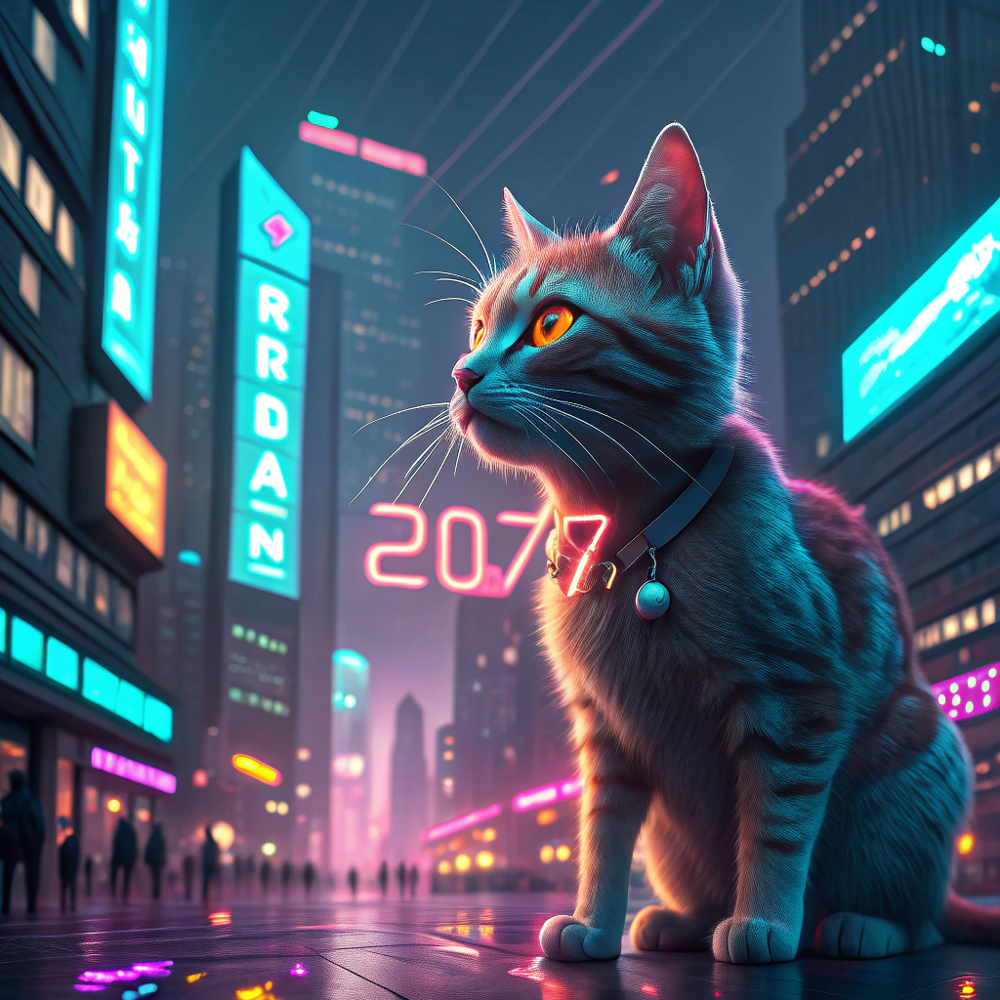

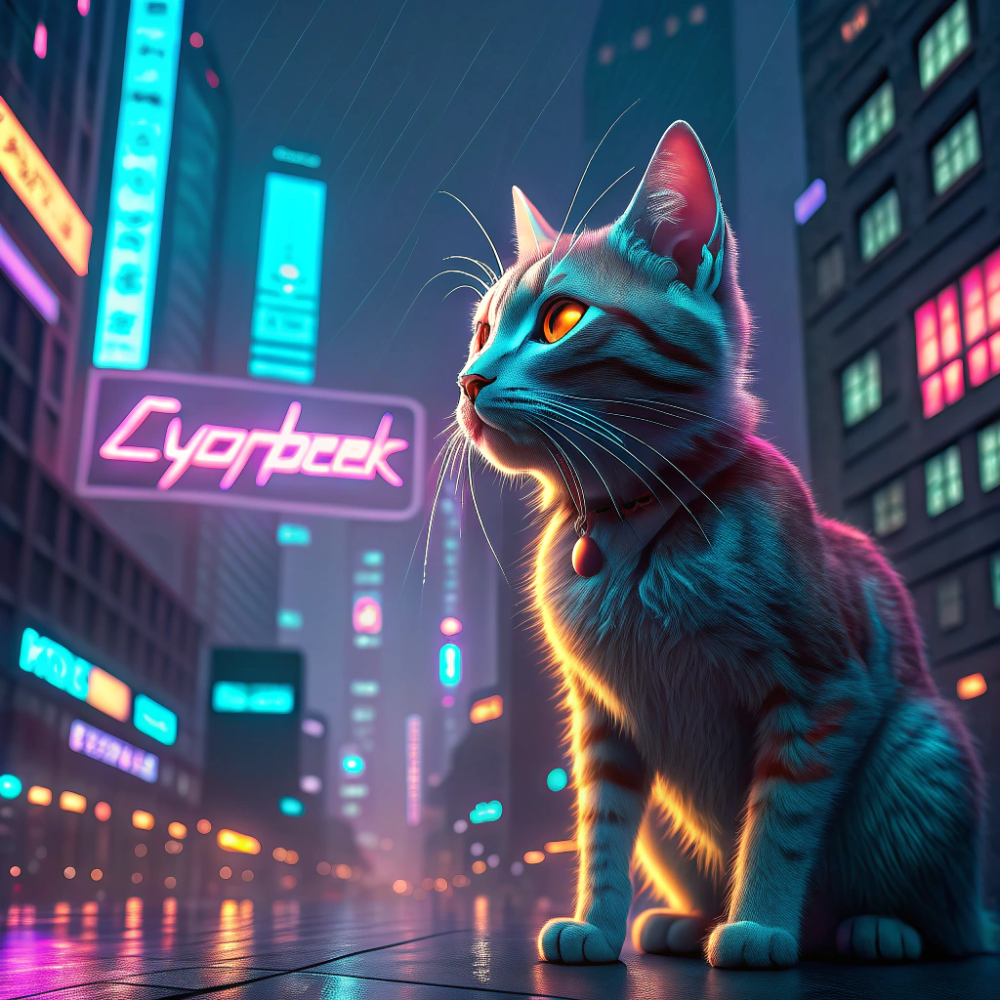

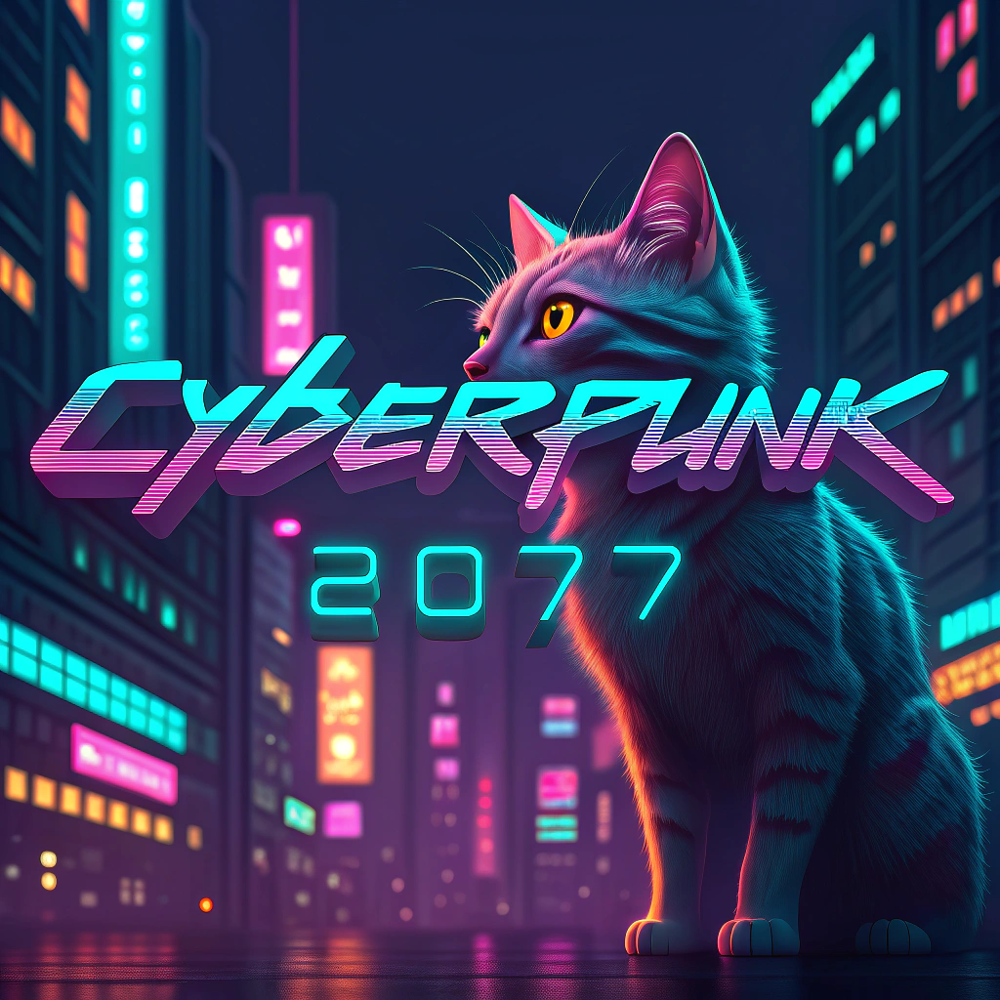

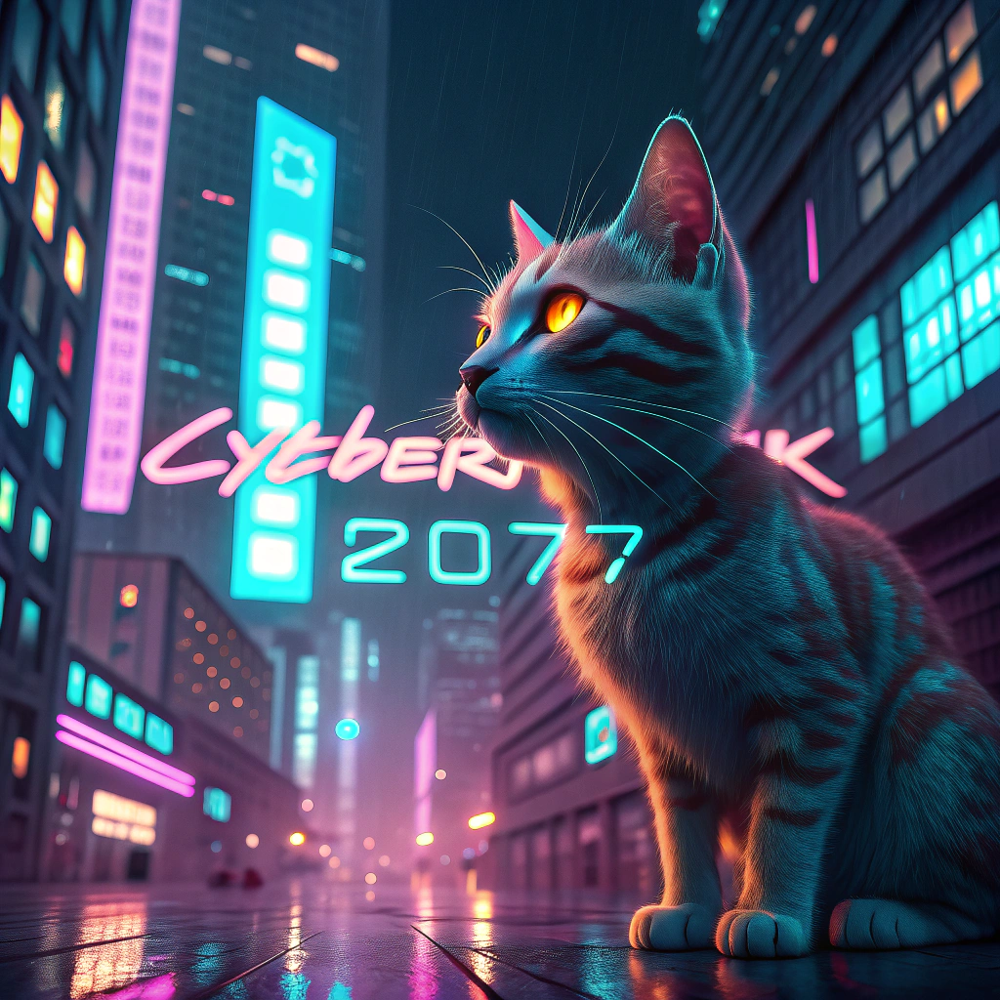

In [ ]:
#@title Add Text
file_name = "image.png" #@param {type:"string"}
text_to_add = "cyberpunk 2077" #@param {type:"string", placeholder: "Тест на картинке"}
result = client.change_image_api(model="add_text", image_path=file_name, prompt=text_to_add)

for group in result:
    for img_path in group:
        display(Image(filename=img_path, width=400))

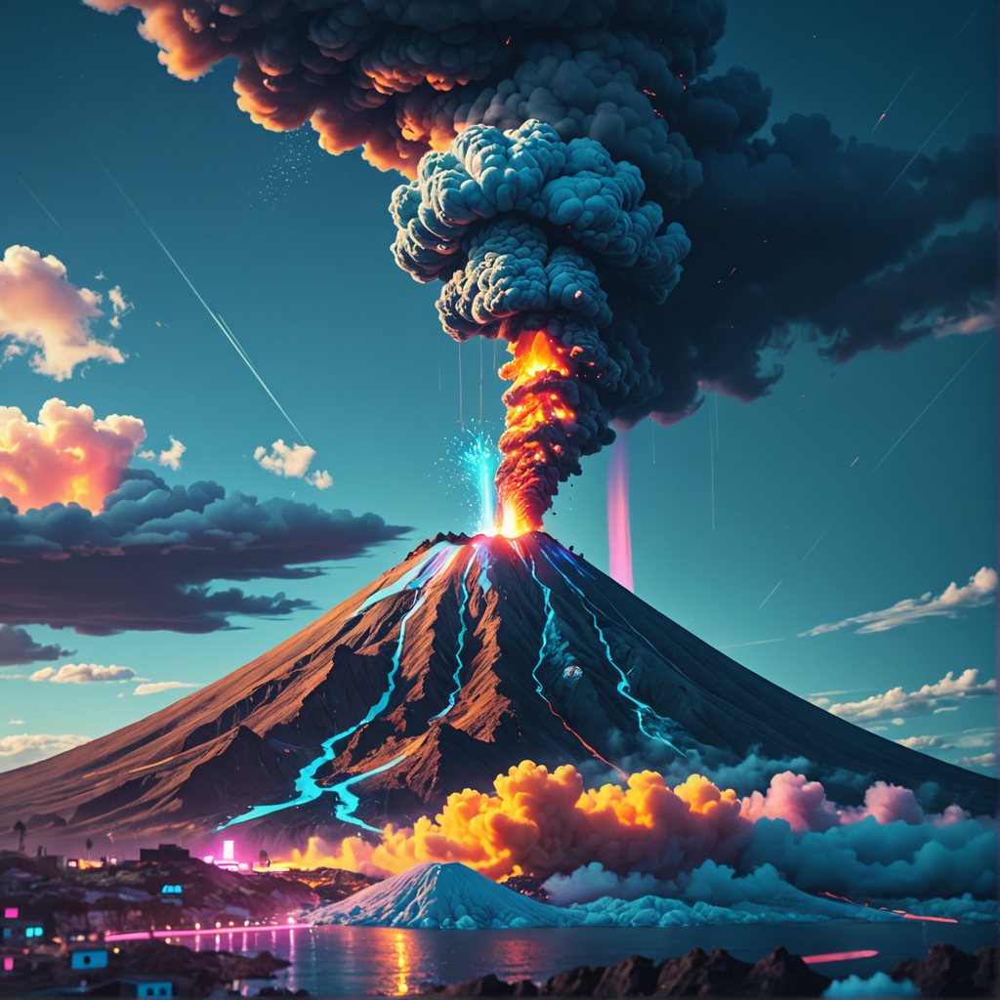

In [ ]:
#@title Style Transfer
file_name = "image.png" #@param {type:"string"}
style_prompt = "Вулкан вдали, облака на небе, контрастные цвета" #@param {type:"string", placeholder: "Запрос"}
result = client.change_image_api(model="style", image_path=file_name, prompt=style_prompt)
img_path = next(result)[0]
display(Image(filename=img_path, width=400))

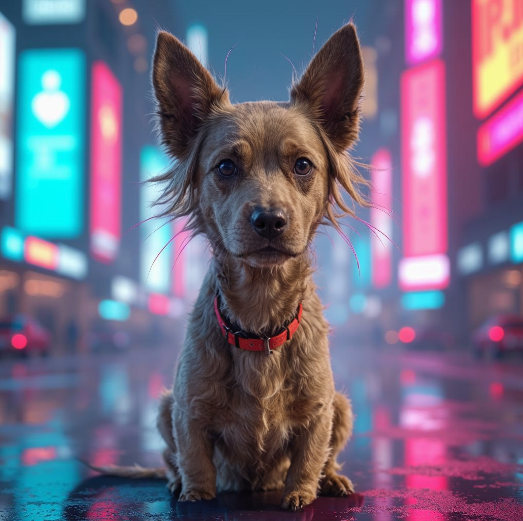

In [ ]:
#@title Search and Replace
file_name = "image.png" #@param {type:"string"}
search_prompt = "Кошка" #@param {type:"string", placeholder: "Что заменить"}
replace_prompt = "Собака" #@param {type:"string", placeholder: "На что заменить"}
result = client.change_image_api(model="search_and_replace", image_path=file_name, prompt=search_prompt, prompt_2=replace_prompt)
img_path = next(result)[0]
display(Image(filename=img_path, width=400))

FileUpload(value={}, accept='image/*', description='Upload')

Загружен файл image.png (471887 байт)


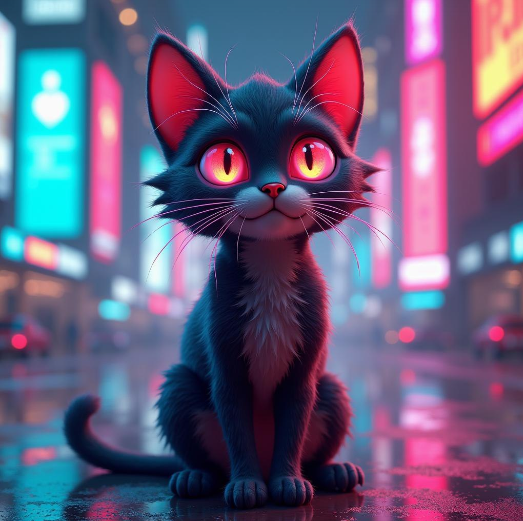

In [ ]:
#@title Загрузка изображения через виджет (Upload Image)
display(upload_widget)

In [ ]:
#@title 3D Model
file_name = "image.png" #@param {type:"string"}
result = client.change_image_api(model="model_3d", image_path=file_name)
model_3d_path = next(result)[0]
display_glb(model_3d_path)

In [ ]:
#@title Генерация музыки
from network_tools import MusicModels
import ipywidgets as widgets
from IPython.display import display, Audio

model_option = "suno_v4"  # @param ["suno_v4", "suno_v3", "riffusion"]
lyrics = "[Instrumental]"  # @param {type:"string", placeholder:"Текст для Suno v4 (не обязателен для riffusion)"}
music_style = "piano"  # @param {type:"string", placeholder:"Жанр музыки"}
instrumental = False  # @param {type:"boolean", placeholder:"Без вокала?"}

file_path = ""  # @param {type:"string", placeholder:"(Необязательно) Только с Riffusion. Путь к аудиофайлу"}

result = client.music_generate_api(
    model=model_option,
    lyrics=lyrics,
    music_style=music_style,
    instrumental=instrumental,
    file_path=file_path
)

audio_url = next(result)
print("🎧 Ссылка на аудио (stream):", audio_url)

audio_files = next(result)
for audio_file in audio_files:
    display(Audio(audio_file))


🎧 Ссылка на аудио (stream): ['https://audiopipe.suno.ai/?item_id=ded51cf9-7a8a-4520-9920-7eb877571f31', 'https://audiopipe.suno.ai/?item_id=aa4ceedf-9231-4088-9ab3-da5ec910ef6b']


In [ ]:
#@title Генерация видео

model_option = "hailuo"  # @param ["hailuo", "stable_video_diffusion"]
prompt = "cat runs"  # @param {type:"string", placeholder:"Запрос (только для Hailuo)"}
file_path = "image.png"  # @param {type:"string", placeholder:"Изображение для видео (необязательно для Hailuo)"}

result = client.video_generate_api(
    model=model_option,
    prompt=prompt,
    image_path=file_path
)

display_video(result)


In [ ]:
#@title Озвучивание текста
model = "hailuo"  # @param ["hailuo"]
text = "Привет, это просто пример произношения текста. Вы можете указать скорость, язык и даже id голоса для озвучки. Метод выдаёт аудио потоком, а потом выводит итоговый файл."  # @param {type:"string"}
speed = 1  # @param {type:"float", min:0.5, max:2.0, step:0.1}  # Скорость озвучивания
lang = "Auto"  # @param ["Auto", "English", "Arabic", "Cantonese", "Chinese (Mandarin)", "Dutch", "French", "German", "Indonesian", "Italian", "Japanese", "Korean", "Portuguese", "Russian", "Spanish", "Turkish", "Ukrainian", "Vietnamese"]
voice_id = "" # @param {type:"string", placeholder:"ID голоса (необязательно)"}

if not voice_id:
    voice_id_map = {
        HailuoLanguages.eng: 236835177529410,
        HailuoLanguages.arb: 226905123659936,
        HailuoLanguages.hk: 209536448462928,
        HailuoLanguages.cmn: 226905123659904,
        HailuoLanguages.nld: 226905123659933,
        HailuoLanguages.fra: 209544421245019,
        HailuoLanguages.deu: 209544421245034,
        HailuoLanguages.ind: 209544421245026,
        HailuoLanguages.ita: 209544421245046,
        HailuoLanguages.jpn: 209533299589242,
        HailuoLanguages.kor: 209536448462935,
        HailuoLanguages.por: 209541892145225,
        HailuoLanguages.rus: 236835177529410,
        HailuoLanguages.spa: 209539195289677,
        HailuoLanguages.tur: 226905123659938,
        HailuoLanguages.ukr: 226905123659940,
        HailuoLanguages.vie: 226905123659934,
        HailuoLanguages.auto: 236835177529410
    }

    voice_id = voice_id_map.get(lang, 236835177529410)  # если язык не найден, используем ID по умолчанию

voice_id = str(voice_id)
# Запрос на создание аудио
audio_file = None
for audio_file, status in client.tts_api(prompt=text, model=model, speed=speed, lang=lang):
    if status == "success":
        print("✅ Готовый аудио:", audio_file)
        display(Audio(audio_file))
    else:
        print("🎶 Потоковый аудио:", audio_file)
        display(Audio(audio_file))

🎶 Потоковый аудио: images/hailuo_stream-0_d3230bac-7b26-41d0-a923-edd05f14063f.mp3


🎶 Потоковый аудио: images/hailuo_stream-1_d3230bac-7b26-41d0-a923-edd05f14063f.mp3


✅ Готовый аудио: images/hailuo_success-0_d3230bac-7b26-41d0-a923-edd05f14063f.mp3
